In [1]:
import numpy as np
import matplotlib.pyplot as plt

def simulate_ball_euler(y0=10.0, v0=0.0, g=9.81, dt=0.1, t_max=5.0, y_floor=0.0, cor=1.0):
    """
    Simulates a jumping ball using the Forward Euler method.
    cor: coefficient of restitution (1.0 for perfect bounce)
    """
    times = np.arange(0, t_max + dt, dt)
    n_steps = len(times)
    positions = np.zeros(n_steps)
    velocities = np.zeros(n_steps)
    
    # Initial conditions
    positions[0] = y0
    velocities[0] = v0
    
    for i in range(n_steps - 1):
        # Current state
        y_current = positions[i]
        v_current = velocities[i]
        
        # Calculate acceleration (constant gravity)
        a = -g
        
        # Update position and velocity using Euler
        positions[i+1] = y_current + v_current * dt
        velocities[i+1] = v_current + a * dt
        
        # Handle bounce
        if positions[i+1] < y_floor and velocities[i+1] < 0: # Ball is below floor and moving downwards
            # Simple bounce: set position to floor and reverse velocity (scaled by COR)
            positions[i+1] = y_floor 
            velocities[i+1] = -velocities[i+1] * cor
            
            # Note: More sophisticated bounce handling might adjust dt to land exactly on the floor.
            # For this demo, simplicity is key to show dt effects. Large dt might show penetration.
            
    return times, positions, velocities

# You can create a similar function 'simulate_ball_verlet' for the Verlet algorithm.
# The bounce logic would be similar, but applied to the Verlet updates.

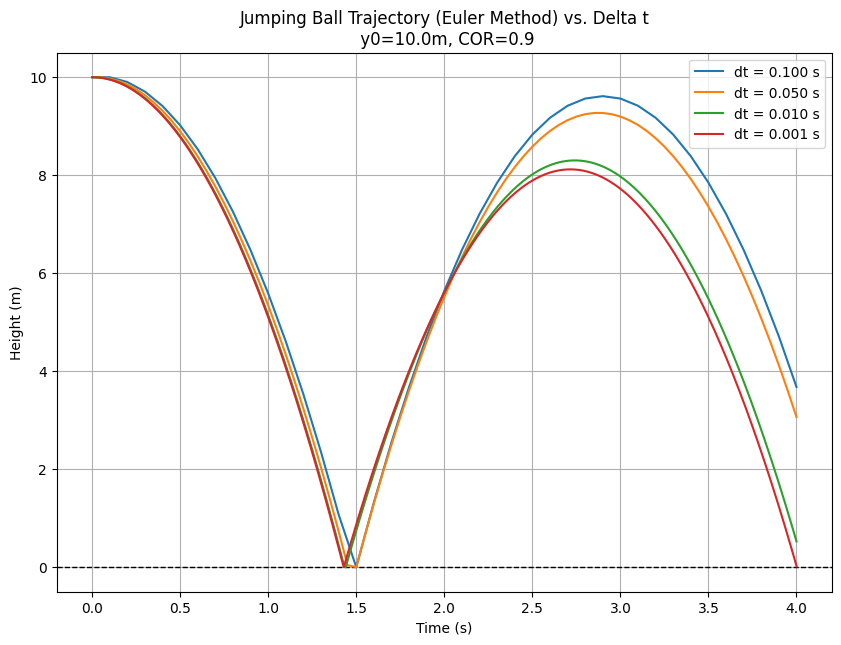

In [2]:
# Simulation parameters
y_initial = 10.0
time_total = 4.0 # Simulate for 4 seconds
g_accel = 9.81
restitution_coeff = 0.9 # Slightly inelastic bounce

# Different delta t values to test
dt_values = [0.1, 0.05, 0.01, 0.001] # From large to small

plt.figure(figsize=(10, 7))
plt.title(f'Jumping Ball Trajectory (Euler Method) vs. Delta t\n y0={y_initial}m, COR={restitution_coeff}')
plt.xlabel('Time (s)')
plt.ylabel('Height (m)')
plt.axhline(0, color='black', linestyle='--', linewidth=1) # Floor

for dt_val in dt_values:
    t, y, v = simulate_ball_euler(y0=y_initial, dt=dt_val, t_max=time_total, 
                                   g=g_accel, cor=restitution_coeff)
    plt.plot(t, y, label=f'dt = {dt_val:.3f} s')

plt.legend()
plt.grid(True)
plt.ylim(bottom=-0.5) # Allow seeing slight penetration if it occurs
plt.show()

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, display # Ensure display is imported

# --- Simulation Parameters ---
y0 = 10.0         # Initial height (meters)
v0 = 0.0          # Initial velocity (m/s)
g = 9.81          # Acceleration due to gravity (m/s^2)
dt = 0.02         # Time step (seconds) - Smaller dt for smoother animation
t_max = 6.0       # Maximum simulation time (seconds)
cor = 0.85        # Coefficient of restitution (0 to 1, 1 is perfectly elastic)
ball_radius = 0.2 # Visual radius of the ball (meters)
floor_y = 0.0     # Position of the floor

# --- Global variables to store simulation data for plotting ---
# These are reset in the init() function to allow re-running the cell
times_data = []
positions_data = []
velocities_data = [] # Added for completeness, though not directly plotted here

# --- Set up the figure and subplots ---
fig, (ax_anim, ax_graph) = plt.subplots(1, 2, figsize=(12, 6))
fig.suptitle(f'Jumping Ball Simulation (dt = {dt}s, COR = {cor})', fontsize=14)


# --- Animation Subplot Setup (Left) ---
ax_anim.set_xlim(-1, 1) # Arbitrary x-limits for the ball's visual space
ax_anim.set_ylim(floor_y - ball_radius, y0 + ball_radius * 2) # Dynamic y-limits
ax_anim.set_xlabel("Visual Space (X)")
ax_anim.set_ylabel("Height (m)")
ax_anim.set_title("Animation")
ax_anim.axhline(floor_y, color='black', linestyle='-', linewidth=2) # Draw the floor
ball_patch = plt.Circle((0, y0), ball_radius, fc='blue', zorder=5) # Ball representation
ax_anim.add_patch(ball_patch)
# Text to display current time, height, and velocity
time_text_anim = ax_anim.text(0.02, 0.97, '', transform=ax_anim.transAxes, 
                              ha='left', va='top', fontsize=9, 
                              bbox=dict(boxstyle='round,pad=0.3', fc='wheat', alpha=0.5))


# --- Graph Subplot Setup (Right) ---
ax_graph.set_xlim(0, t_max)
ax_graph.set_ylim(floor_y - 0.1, y0 + 0.5) # Slightly more room for the graph
ax_graph.set_xlabel("Time (s)")
ax_graph.set_ylabel("Height (m)")
ax_graph.set_title("Height vs. Time Graph")
ax_graph.axhline(floor_y, color='black', linestyle='--', linewidth=1) # Floor line on graph
line_graph, = ax_graph.plot([], [], 'r-', lw=2) # Line for the trajectory
ax_graph.grid(True)

# --- Initialization function for the animation ---
def init():
    """Initializes the animation elements."""
    global times_data, positions_data, velocities_data # Allow modification
    
    # Reset global data for re-runs in Jupyter
    times_data = [0.0] # Start time at 0
    positions_data = [y0]
    velocities_data = [v0]
    
    ball_patch.center = (0, y0)
    line_graph.set_data(times_data, positions_data) # Start graph with initial point
    time_text_anim.set_text(f'Time: {0.0:.2f}s\nHeight: {y0:.2f}m\nVelocity: {v0:.2f}m/s')
    
    # Adjust graph y-limits based on initial height
    ax_graph.set_ylim(floor_y - 0.1 * y0, y0 + 0.2 * y0) # More dynamic y-limits for graph
    
    return ball_patch, line_graph, time_text_anim

# --- Animation update function (called for each frame) ---
def update(frame_num):
    """Updates the animation for each frame."""
    global times_data, positions_data, velocities_data # Allow modification

    # Get the current state from the end of our data lists
    current_time = times_data[-1]
    current_y = positions_data[-1]
    current_v = velocities_data[-1]

    # Stop condition for the simulation data generation
    if current_time >= t_max:
        # Stop adding data, but let animation play out existing frames if any discrepancy
        # The `frames` argument in FuncAnimation should handle the number of calls.
        return ball_patch, line_graph, time_text_anim

    # --- Euler Integration Step ---
    # Update velocity (v_new = v_old + a * dt)
    # Note: For Euler, acceleration at the *start* of the interval is used.
    # For this simple case, acceleration (g) is constant.
    v_after_gravity = current_v - g * dt
    
    # Update position (y_new = y_old + v_old * dt)
    # Using v_current (velocity at the start of the interval) for Euler position update
    y_after_gravity = current_y + current_v * dt 
    
    # Store these as the "next potential state"
    new_v = v_after_gravity
    new_y = y_after_gravity

    # --- Collision Detection and Response ---
    # Check if the *bottom* of the ball hits or is below the floor
    if new_y - ball_radius < floor_y and new_v < 0: # Ball is at/below floor and moving down
        # Correct position to be exactly on the floor
        # This is a simplification. A more precise method would calculate the exact time of impact.
        new_y = floor_y + ball_radius 
        
        # Reverse velocity and apply coefficient of restitution
        new_v = -new_v * cor      
        
        # Optional: If the ball significantly overshot due to large dt,
        # we might lose some energy that wasn't accounted for during the "penetration".
        # For this demo, this simple correction is usually acceptable.

    # --- Update animation elements ---
    ball_patch.center = (0, new_y)
    
    # --- Update data for the graph ---
    next_time = current_time + dt
    times_data.append(next_time)
    positions_data.append(new_y)
    velocities_data.append(new_v) # Store the velocity *after* potential bounce
    
    line_graph.set_data(times_data, positions_data) # Update graph with all data up to current time
    
    # Update time text
    time_text_anim.set_text(f'Time: {next_time:.2f}s\nHeight: {new_y:.2f}m\nVelocity: {new_v:.2f}m/s')

    # Dynamically adjust graph y-limits if the ball goes higher than current plot limit
    # This can be useful but can also make the plot axes jump around.
    if new_y > ax_graph.get_ylim()[1] - 0.1 * y0 : 
        ax_graph.set_ylim(floor_y - 0.1 * y0, new_y + 0.2 * y0)
        # ax_graph.figure.canvas.draw_idle() # Request a redraw if limits change

    return ball_patch, line_graph, time_text_anim

# --- Create the animation ---
# Calculate the number of frames based on dt and t_max
# Add a small epsilon to ensure the last step is included if t_max is a multiple of dt
num_frames = int(t_max / dt) + 1 

# blit=True means only re-draw the parts that have changed.
# interval is the delay between frames in milliseconds.
# Try blit=False if you encounter issues, though it will be slower.
anim = animation.FuncAnimation(fig, update, frames=num_frames,
                               init_func=init, blit=True, interval=dt*1000, repeat=False)

# --- Display the animation IN JUPYTER NOTEBOOK/LAB ---
# Option 1: Display as JSHTML (often more reliable and interactive)
# Make sure to close the static plot that Matplotlib might try to show first.
plt.close(fig) # Prevents static plot from showing before animation
display(HTML(anim.to_jshtml()))

# Option 2: Display as HTML5 video (alternative for Jupyter)
# plt.close(fig)
# display(HTML(anim.to_html5_video()))

# Option 3: If NOT in Jupyter, or if the above fails, try plt.show()
# This might require a specific Matplotlib backend to be configured for animation.
# plt.show()

# To save the animation (optional, uncomment one and ensure you have the writer installed):
# print("Saving animation... (this may take a moment)")
# anim.save('jumping_ball_simulation.gif', writer='imagemagick', fps=int(1/dt))
# anim.save('jumping_ball_simulation.mp4', writer='ffmpeg', fps=int(1/dt))
# print("Animation saved.")


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, display # Ensure display is imported

# --- Simulation Parameters ---
y0 = 10.0         # Initial height (meters)
v0 = 0.0          # Initial velocity (m/s)
g = 9.81          # Acceleration due to gravity (m/s^2)
dt = 0.02         # Time step (seconds) - Smaller dt for smoother animation
t_max = 6.0       # Maximum simulation time (seconds)
cor = 0.85        # Coefficient of restitution (0 to 1, 1 is perfectly elastic)
ball_radius = 0.2 # Visual radius of the ball (meters)
floor_y = 0.0     # Position of the floor

# --- Global variables to store simulation data for plotting ---
# These are reset in the init() function to allow re-running the cell
times_data = []
positions_data = []
velocities_data = []

# --- Set up the figure and subplots ---
fig, (ax_anim, ax_graph) = plt.subplots(1, 2, figsize=(12, 6))
fig.suptitle(f'Jumping Ball Simulation (dt = {dt}s, COR = {cor})', fontsize=14)


# --- Animation Subplot Setup (Left) ---
ax_anim.set_xlim(-1, 1) # Arbitrary x-limits for the ball's visual space
ax_anim.set_ylim(floor_y - ball_radius, y0 + ball_radius * 2)
ax_anim.set_xlabel("Visual Space (X)")
ax_anim.set_ylabel("Height (m)")
ax_anim.set_title("Animation")
ax_anim.axhline(floor_y, color='black', linestyle='-', linewidth=2) # Draw the floor

# ***** THIS IS THE KEY CHANGE FOR A CIRCULAR BALL *****
ax_anim.set_aspect('equal', adjustable='box') 
# ***** END OF KEY CHANGE *****

ball_patch = plt.Circle((0, y0), ball_radius, fc='blue', zorder=5) # Ball representation
ax_anim.add_patch(ball_patch)
# Text to display current time, height, and velocity
time_text_anim = ax_anim.text(0.02, 0.97, '', transform=ax_anim.transAxes, 
                              ha='left', va='top', fontsize=9, 
                              bbox=dict(boxstyle='round,pad=0.3', fc='wheat', alpha=0.5))


# --- Graph Subplot Setup (Right) ---
ax_graph.set_xlim(0, t_max)
ax_graph.set_ylim(floor_y - 0.1, y0 + 0.5)
ax_graph.set_xlabel("Time (s)")
ax_graph.set_ylabel("Height (m)")
ax_graph.set_title("Height vs. Time Graph")
ax_graph.axhline(floor_y, color='black', linestyle='--', linewidth=1) # Floor line on graph
line_graph, = ax_graph.plot([], [], 'r-', lw=2) # Line for the trajectory
ax_graph.grid(True)

# --- Initialization function for the animation ---
def init():
    """Initializes the animation elements."""
    global times_data, positions_data, velocities_data 
    
    times_data = [0.0] 
    positions_data = [y0]
    velocities_data = [v0]
    
    ball_patch.center = (0, y0)
    line_graph.set_data(times_data, positions_data) 
    time_text_anim.set_text(f'Time: {0.0:.2f}s\nHeight: {y0:.2f}m\nVelocity: {v0:.2f}m/s')
    
    ax_graph.set_ylim(floor_y - 0.1 * y0, y0 + 0.2 * y0) 
    
    return ball_patch, line_graph, time_text_anim

# --- Animation update function (called for each frame) ---
def update(frame_num):
    """Updates the animation for each frame."""
    global times_data, positions_data, velocities_data 

    current_time = times_data[-1]
    current_y = positions_data[-1]
    current_v = velocities_data[-1]

    if current_time >= t_max:
        return ball_patch, line_graph, time_text_anim

    v_after_gravity = current_v - g * dt
    y_after_gravity = current_y + current_v * dt 
    
    new_v = v_after_gravity
    new_y = y_after_gravity

    if new_y - ball_radius < floor_y and new_v < 0: 
        new_y = floor_y + ball_radius 
        new_v = -new_v * cor      
        
    ball_patch.center = (0, new_y)
    
    next_time = current_time + dt
    times_data.append(next_time)
    positions_data.append(new_y)
    velocities_data.append(new_v) 
    
    line_graph.set_data(times_data, positions_data) 
    
    time_text_anim.set_text(f'Time: {next_time:.2f}s\nHeight: {new_y:.2f}m\nVelocity: {new_v:.2f}m/s')

    if new_y > ax_graph.get_ylim()[1] - 0.1 * y0 : 
        ax_graph.set_ylim(floor_y - 0.1 * y0, new_y + 0.2 * y0)

    return ball_patch, line_graph, time_text_anim

# --- Create the animation ---
num_frames = int(t_max / dt) + 1 

anim = animation.FuncAnimation(fig, update, frames=num_frames,
                               init_func=init, blit=True, interval=dt*1000, repeat=False)

# --- Display the animation IN JUPYTER NOTEBOOK/LAB ---
plt.close(fig) 
display(HTML(anim.to_jshtml()))



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, display

# --- Increase Matplotlib's animation embedding limit ---
# Default is 20MB, error showed ~21MB. Setting to 50MB for safety.
plt.rcParams['animation.embed_limit'] = 150.0 

# --- Simulation Parameters ---
y0 = 10.0         # Initial height (meters)
v0 = 0.0          # Initial velocity (m/s)
g = 9.81          # Acceleration due to gravity (m/s^2)
cor = 0.80        # Coefficient of restitution (e.g., 0.8 means it loses 20% of impact velocity)
ball_radius = 0.2 # Visual radius of the ball (meters)
floor_y = 0.0     # Position of the floor

# --- Animation Specific Parameters ---
dt_anim = 0.02    # Time step for the animation (small for smoothness)
t_max_anim = 15.0 # Max simulation time for animation (long enough for ball to stop)

# --- dt Comparison Parameters ---
dt_small = 0.005  # A small, more "accurate" dt for comparison
dt_large = 0.1    # A larger, less accurate dt for comparison
t_max_comparison = 5.0 # Max time for the static comparison plots

# --- Global variables for LIVE animation data ---
times_anim_data = []
positions_anim_data = []
velocities_anim_data = []
ball_stopped_flag = False # Flag to indicate if the ball has effectively stopped bouncing

# --- Helper function to run simulation for static dt comparison plot ---
def run_simulation(y_init, v_init, sim_dt, sim_t_max, sim_cor, sim_g, sim_ball_radius):
    """Runs a standalone simulation and returns time and position arrays."""
    _times = np.arange(0, sim_t_max + sim_dt, sim_dt)
    _positions = np.zeros(len(_times))
    _velocities = np.zeros(len(_times))

    _positions[0] = y_init
    _velocities[0] = v_init
    
    min_bounce_velocity_threshold = 0.05 # If bounce velocity is less than this, it's effectively stopped

    for i in range(len(_times) - 1):
        y_curr = _positions[i]
        v_curr = _velocities[i]

        v_next_no_bounce = v_curr - sim_g * sim_dt
        y_next_no_bounce = y_curr + v_curr * sim_dt # Euler position update

        _velocities[i+1] = v_next_no_bounce
        _positions[i+1] = y_next_no_bounce

        if _positions[i+1] - sim_ball_radius < floor_y and _velocities[i+1] < 0:
            _positions[i+1] = floor_y + sim_ball_radius
            _velocities[i+1] = -_velocities[i+1] * sim_cor
            if abs(_velocities[i+1]) < min_bounce_velocity_threshold and _positions[i+1] == floor_y + sim_ball_radius:
                 # If ball is on floor and bounce velocity is tiny, make it stay on floor
                for j in range(i + 1, len(_times)):
                    _positions[j] = floor_y + sim_ball_radius
                    _velocities[j] = 0.0
                break # Exit loop as ball has stopped
    return _times, _positions

# --- Pre-calculate trajectories for the static dt comparison graph ---
times_small_dt, positions_small_dt = run_simulation(y0, v0, dt_small, t_max_comparison, cor, g, ball_radius)
times_large_dt, positions_large_dt = run_simulation(y0, v0, dt_large, t_max_comparison, cor, g, ball_radius)


# --- Set up the figure and subplots (1 row, 3 columns) ---
fig, (ax_anim, ax_graph_live, ax_graph_dt) = plt.subplots(1, 3, figsize=(18, 6))
fig.suptitle(f'Jumping Ball Simulation (Animation dt = {dt_anim}s, COR = {cor})', fontsize=16)

# --- 1. Animation Subplot Setup (Left) ---
ax_anim.set_xlim(-1, 1)
ax_anim.set_ylim(floor_y - ball_radius, y0 + ball_radius * 2)
ax_anim.set_xlabel("Visual Space (X)")
ax_anim.set_ylabel("Height (m)")
ax_anim.set_title("Ball Animation")
ax_anim.axhline(floor_y, color='black', linestyle='-', linewidth=2)
ax_anim.set_aspect('equal', adjustable='box') # Make ball circular
ball_patch = plt.Circle((0, y0), ball_radius, fc='dodgerblue', zorder=5)
ax_anim.add_patch(ball_patch)
anim_text_display = ax_anim.text(0.02, 0.97, '', transform=ax_anim.transAxes,
                                 ha='left', va='top', fontsize=9,
                                 bbox=dict(boxstyle='round,pad=0.3', fc='aliceblue', alpha=0.7))

# --- 2. Live Height vs. Time Graph Subplot Setup (Middle) ---
ax_graph_live.set_xlim(0, t_max_anim) # Use animation t_max
ax_graph_live.set_ylim(floor_y - 0.1 * y0, y0 + 0.2 * y0)
ax_graph_live.set_xlabel("Time (s)")
ax_graph_live.set_ylabel("Height (m)")
ax_graph_live.set_title("Live Trajectory")
ax_graph_live.axhline(floor_y, color='black', linestyle='--', linewidth=1)
live_line_graph, = ax_graph_live.plot([], [], 'r-', lw=2)
ax_graph_live.grid(True)

# --- 3. Static dt Comparison Graph Subplot Setup (Right) ---
ax_graph_dt.set_xlabel("Time (s)")
ax_graph_dt.set_ylabel("Height (m)")
ax_graph_dt.set_title(f"Effect of dt (Small: {dt_small}s, Large: {dt_large}s)")
ax_graph_dt.plot(times_small_dt, positions_small_dt, 'g-', lw=2, label=f'dt = {dt_small}s (Small)')
ax_graph_dt.plot(times_large_dt, positions_large_dt, 'm--', lw=2, label=f'dt = {dt_large}s (Large)')
ax_graph_dt.axhline(floor_y, color='black', linestyle='--', linewidth=1)
ax_graph_dt.legend()
ax_graph_dt.grid(True)
ax_graph_dt.set_xlim(0, t_max_comparison)
ax_graph_dt.set_ylim(floor_y - 0.1 * y0, y0 + 0.2 * y0)


# --- Initialization function for the animation ---
def init_animation():
    global times_anim_data, positions_anim_data, velocities_anim_data, ball_stopped_flag

    times_anim_data = [0.0]
    positions_anim_data = [y0]
    velocities_anim_data = [v0]
    ball_stopped_flag = False

    ball_patch.center = (0, y0)
    live_line_graph.set_data(times_anim_data, positions_anim_data)
    anim_text_display.set_text(f'Time: {0.0:.2f}s\nHeight: {y0:.2f}m\nVelocity: {v0:.2f}m/s')
    
    # Adjust live graph y-limits based on initial height
    ax_graph_live.set_ylim(floor_y - 0.1 * y0, y0 + 0.2 * y0)
    return ball_patch, live_line_graph, anim_text_display

# --- Animation update function (called for each frame) ---
def update_animation(frame_num):
    global times_anim_data, positions_anim_data, velocities_anim_data, ball_stopped_flag

    current_time = times_anim_data[-1]
    current_y = positions_anim_data[-1]
    current_v = velocities_anim_data[-1]
    
    min_bounce_velocity_for_anim_stop = 0.05 # Threshold for visual stopping

    if current_time >= t_max_anim:
        return ball_patch, live_line_graph, anim_text_display

    next_time = current_time + dt_anim
    new_v = current_v
    new_y = current_y

    if not ball_stopped_flag:
        v_after_gravity = current_v - g * dt_anim
        y_after_gravity = current_y + current_v * dt_anim # Euler position update

        new_v = v_after_gravity
        new_y = y_after_gravity

        if new_y - ball_radius < floor_y and new_v < 0:
            new_y = floor_y + ball_radius
            new_v = -new_v * cor
            if abs(new_v) < min_bounce_velocity_for_anim_stop and new_y == floor_y + ball_radius:
                ball_stopped_flag = True # Ball has visually stopped bouncing
                new_v = 0.0 # Ensure it stays put
    else: # If ball has stopped
        new_y = floor_y + ball_radius
        new_v = 0.0

    ball_patch.center = (0, new_y)

    times_anim_data.append(next_time)
    positions_anim_data.append(new_y)
    velocities_anim_data.append(new_v)

    live_line_graph.set_data(times_anim_data, positions_anim_data)
    anim_text_display.set_text(f'Time: {next_time:.2f}s\nHeight: {new_y:.2f}m\nVelocity: {new_v:.2f}m/s\n{"Stopped" if ball_stopped_flag else "Bouncing"}')

    if not ball_stopped_flag and new_y > ax_graph_live.get_ylim()[1] - 0.1 * y0:
        ax_graph_live.set_ylim(floor_y - 0.1 * y0, new_y + 0.2 * y0)

    return ball_patch, live_line_graph, anim_text_display

# --- Create the animation ---
num_anim_frames = int(t_max_anim / dt_anim) + 1

anim = animation.FuncAnimation(fig, update_animation, frames=num_anim_frames,
                               init_func=init_animation, blit=True, interval=dt_anim*1000, repeat=False)

# --- Display the animation IN JUPYTER NOTEBOOK/LAB ---
plt.tight_layout(rect=[0, 0, 1, 0.96]) # Adjust layout to prevent suptitle overlap
plt.close(fig)
display(HTML(anim.to_jshtml()))

